In [1]:
# Importing necessary packages
import os
import cv2
import numpy as np
import pandas as pd
%matplotlib inline
import segment

import matplotlib.pyplot as plt
plt.close()
import seaborn as sns

In [2]:
# Trying different color spaces to find best color channel.
def preprocess_input(path):

    image_read = cv2.imread(path)  
    
    image = image_read
    if image is None:
        return -1
    
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
#     plt.imshow(img_rgb)
#     plt.title("RGB")
#     plt.show()
    
    img_lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
#     plt.imshow(img_lab)
#     plt.show()
    
    img_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
#     plt.imshow(img_hsv)
#     plt.show()

    fig, ax = plt.subplots(1,3, figsize=(15,15))
#     ax[0].imshow(img_rgb)
#     ax[0].title.set_text("IMGRGB")
#     ax[1].imshow(img_lab)
#     ax[1].title.set_text("IMGLAB")
#     ax[2].imshow(img_hsv)
#     ax[2].title.set_text("IMGHSV")

    R = img_rgb[:, :, 0]
    G = img_rgb[:, :, 1]
    B = img_rgb[:, :, 2]
    fig, ax = plt.subplots(1,3, figsize=(15,15))
#     ax[0].imshow(R)
#     ax[0].title.set_text("R")
#     ax[1].imshow(G)
#     ax[1].title.set_text("G")
#     ax[2].imshow(B)
#     ax[2].title.set_text("B")
    
    L = img_lab[:, :, 0]
    a = img_lab[:, :, 1]
    b = img_lab[:, :, 2]
    fig, ax = plt.subplots(1,3, figsize=(15,15))
#     ax[0].imshow(L)
#     ax[0].title.set_text("L")
#     ax[1].imshow(a)
#     ax[1].title.set_text("b")
#     ax[2].imshow(b)
#     ax[2].title.set_text("a")
    
    H = img_hsv[:, :, 0]
    S = img_hsv[:, :, 1]
    V = img_hsv[:, :, 2]
    fig, ax = plt.subplots(1,3, figsize=(15,15))
#     ax[0].imshow(H)
#     ax[0].title.set_text("H")
#     ax[1].imshow(S)
#     ax[1].title.set_text("S")
#     ax[2].imshow(V)
#     ax[2].title.set_text("V")
    
    pixel_vals = b.flatten()
    pixel_vals = np.float32(pixel_vals)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 2.0)
    # Since we are interested in only actual leaf pixels, we choose 2 clusters
    # one cluster for actual leaf pixels and other for unwanted background pixels.
    K = 2
    
#     retval, labels, centers = cv2.kmeans(pixel_vals, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    
    centroids = np.array([[25],[55]]).astype(np.int32)
    centroid_labels = np.random.randint(K, size=pixel_vals.shape, dtype=np.int32)
    
    retval, labels, centers = cv2.kmeans(data = pixel_vals,
                                         K = K,
                                         bestLabels = centroid_labels,
                                         criteria = criteria,
                                         attempts = 20,
                                         flags = cv2.KMEANS_USE_INITIAL_LABELS,
                                         centers = centroids)
#     lb = labels.copy()
#     if labels[0] == 1 :
#         lb[labels==1] = 0
#         lb[labels==0] = 1
#     labels = lb
#     print("retval",retval)
#     print("/n")
#     print("labels",labels)
#     print("/n")
#     print("centers",centers)
#     print("/n")

#     retval, labels, centers = cv2.kmeans(pixel_vals, K, None, criteria, 10, cv2.KMEANS_PP_CENTERS)
    
    centers = np.uint8(centers)    
    segmented_data = centers[labels.flatten()]
    segmented_image = segmented_data.reshape((b.shape))
    
    pixel_labels = labels.reshape(img_lab.shape[0], img_lab.shape[1])
    # displaying segmented image
    
    count_nonzero = np.count_nonzero(pixel_labels)
    count_zero = pixel_labels.size - count_nonzero
    
#     print("Non-Zero",count_nonzero)
#     print("Zero",count_zero)
#     plt.imshow(pixel_labels)
#     plt.show()
    
    # Doing this, some unwanted pixels that are clustered in main cluster can be avoided.
    # Ref - https://docs.opencv.org/3.4/d3/dc0/group__imgproc__shape.html#gac2718a64ade63475425558aa669a943a
#     pixel_labels = np.uint8(pixel_labels)
#     ret, components = cv2.connectedComponents(pixel_labels, connectivity=4)
# #     plt.imshow(components, cmap='gray')
# #     plt.show()
    
#     indices = []
#     for i in range(1, ret):
#         row, col = np.where(components==i)
#         indices.append(max(len(row), len(col)))
#     component = np.argmax(np.array(indices))
#     main_component = component+1   #indexing starts from 0, so we increment by 1 to get actual component index
# #     # creating a mask and extracting pixels corresponding to cluster to which leaf belongs.
# #     # 1 for actual leaf pixels and 0 for other pixels
    
#     mask = np.where(components==main_component, 1, 0)
        
#     B = image_read[:, :, 0]
#     G = image_read[:, :, 1]
#     R = image_read[:, :, 2]
#     # Extract only masked pixels
#     r = R*mask
#     g = G*mask
#     b = B*mask
#     final_img = np.dstack((r, g, b))
#     plt.imshow(pixel_labels,cmap='gray')
#     plt.title("Segemented")
    plt.show()
    
    seg = img_rgb.copy()
    
    seg_image = segmented_image.copy()
    seg_image[segmented_image == np.max(segmented_image)] = 1
    seg_image[segmented_image == np.min(segmented_image)] = 0
    
#     print(seg_image)    
#     print(segmented_image)
#     print(seg[seg_image == 0])
#     print(seg[seg_image != 0])
    
    
    seg[seg_image == 0] = 0
    seg[seg_image != 0] = img_rgb[seg_image != 0]
        
    final_img = seg
    
    
    plt.imshow(final_img)
    plt.title("FINAL")
    plt.show()
    
    return final_img


In [3]:
# def preprocess_input(path):
#     image = cv2.imread(path)
    
#     img_lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
#     b = img_lab[:, :, 2]
    
#     gaussian_image = cv2.GaussianBlur(image, (7,7), 0)
    
# #     image_vectorized = b.reshape(-1, 3)
#     image_vectorized = b.flatten()
#     image_vectorized = np.float32(image_vectorized)
    
#     criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
#     K = 2
    
#     ret, labels, centers = cv2.kmeans(image_vectorized, K, None, criteria, 10, cv2.KMEANS_PP_CENTERS)
#     res = centers[labels.flatten()]
#     segmented_image = res.reshape((image.shape))
    
#     label = labels.reshape((gaussian_image.shape[0], gaussian_image.shape[1]))
#     output = np.uint8(segmented_image)
    
#     components = np.zeros(image.shape, np.uint8)
#     components[label == 1] = image[label == 1]
    
#     plt.imshow(components)
#     plt.show()

In [4]:
source = './Orginal/train/'
dest = "./Segmented/train/"

In [5]:
# path = './Orginal/train/Tomato_Leaf_Mold/d3f5e817-d531-4f9b-ac58-a9bf80518f85___Crnl_L.Mold 8988_flipTB.JPG'
# preprocess_input(path)

Tomato_Leaf_Mold


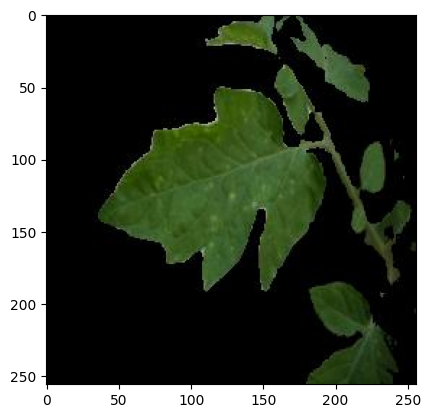

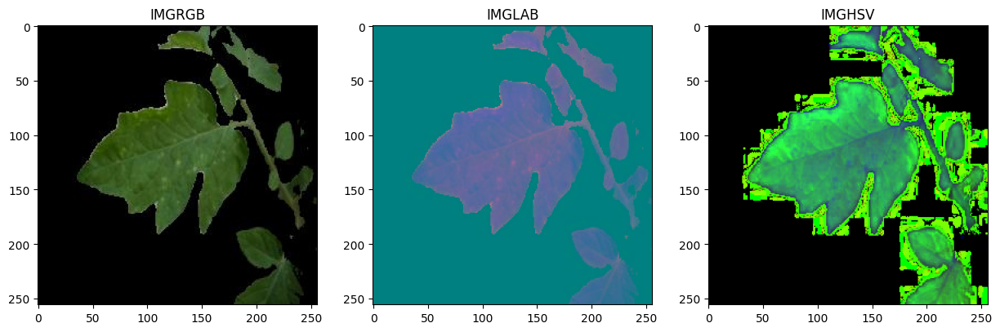

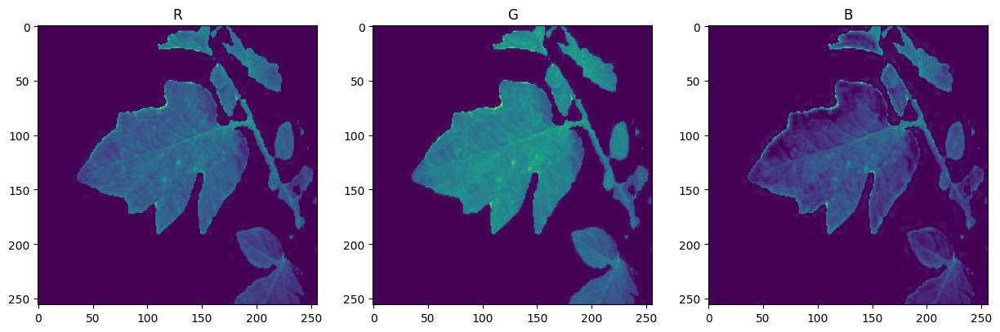

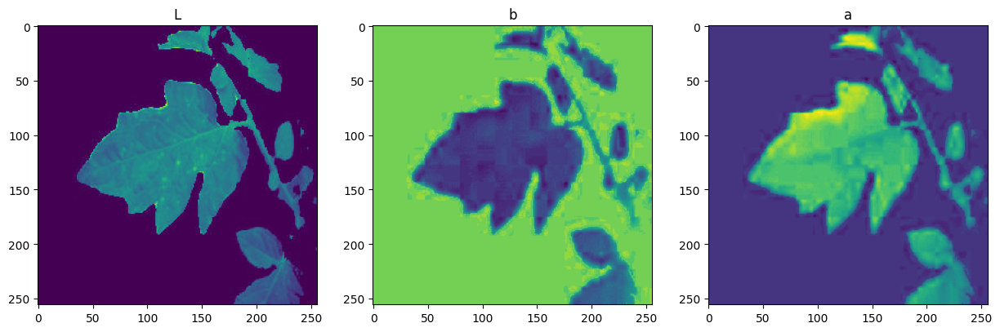

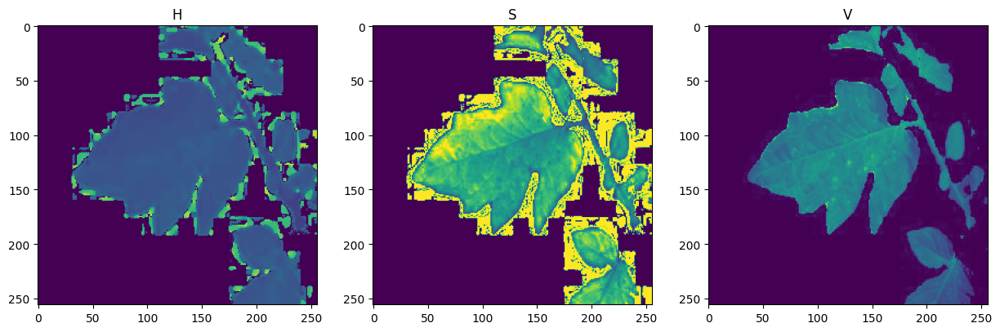

...

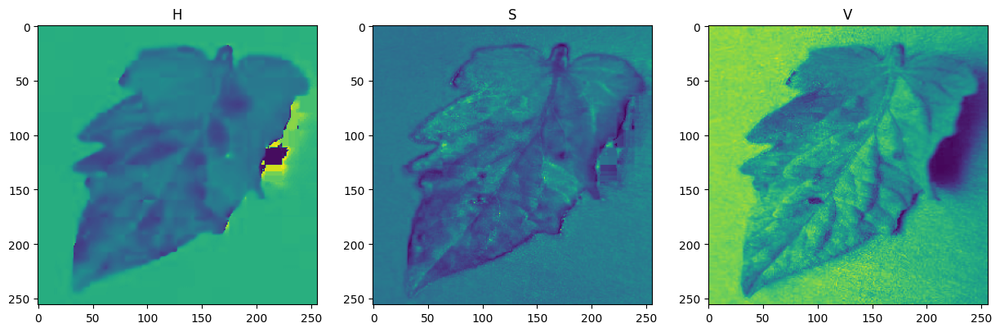

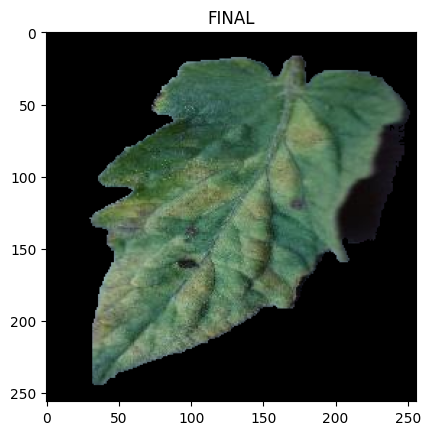

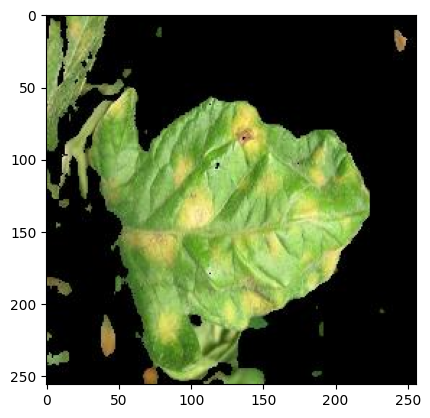

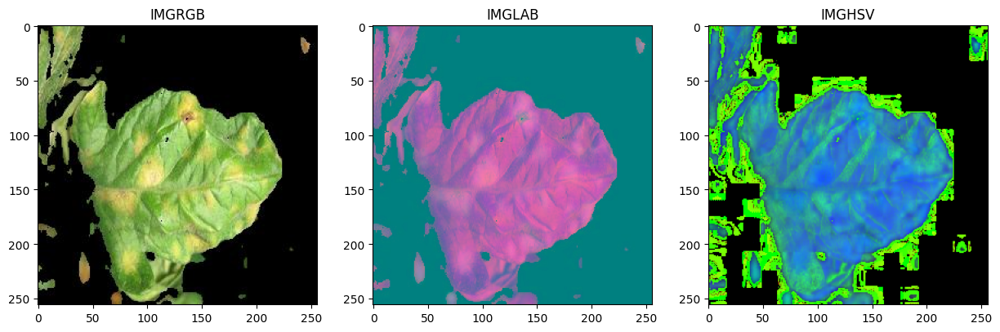

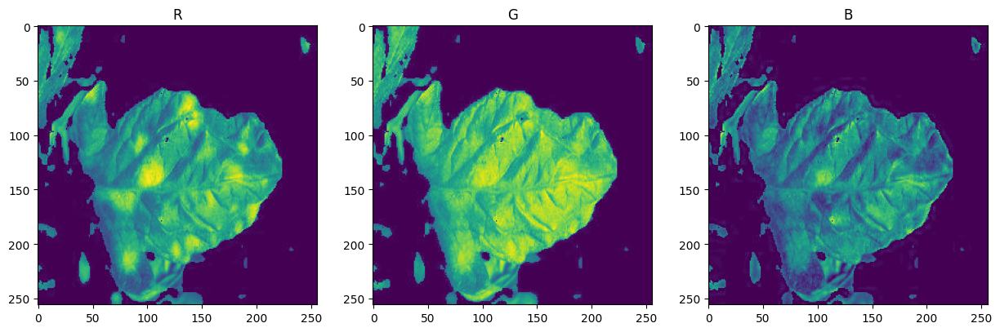

In [ ]:
directories = os.listdir(source)
for dirs in directories:
    subdir = os.listdir(source+dirs)
    print(dirs)
#     os.mkdir(dest+dirs)
    for subdirs in subdir:
        image_path = str(source)+str(dirs)+str("/")+str(subdirs)   
        plt.imshow(plt.imread(image_path))
        a = preprocess_input(image_path)
#         plt.imshow(a)
#         plt.show()
#         plt.imsave(dest+dirs+"/"+subdirs,a)